# FINAL EDA & Modeling Workbook (Project V2)

* [EDA](#simple-eda)
    - [Choosing Genre to Model](#choosing-genre)
    - [Initial Statistics: Hip-Hop Tracks](#stats)
    - [Log-Transforming "Artist Followers" Feature](#log-followers)
* [Modeling & Tuning](#modeling)
    - [Baseline Linear Regression Model](#baseline)
    - [Reducing Overfitting / Model Complexity: Selecting LASSO vs. Ridge](#reducing-overfit)
    - [Experiment: Pre-Removing Features that LASSO Removed & Re-Running Different Models](#removing)
    - [Experiment: Polynomial Regression](#poly)
    - [Tuning Final Ridge Regression Model](#tuning)
    - [Evaluating Model on Linear Regression Assumptions](#assumptions)
* [Final Model](#final-model)
---

In [1]:
%config InlineBackend.figure_formats = ['retina']

import sys
import math
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
import numpy as np

from sklearn.linear_model import Lasso, Ridge, LassoCV, RidgeCV
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures, StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.metrics import mean_squared_error

sys.path.append('..')
from utilities.modeling_utilities import pair_plot_for_music_genre, score_baseline_linear_regression_model, \
                                            manual_cross_validate, manual_cross_validate_poly

Load data.

In [2]:
dataset_v2 = pd.read_pickle('../data/dataset_v2.pkl')

<h2><a id=simple-eda>EDA</a></h2>

Visualize distributions of each feature and potential linearities between each feature and the target, as well as amongst the features.

In [3]:
sns.pairplot(dataset_v2)

<h3><a id='choosing-genre'>Choosing Genre to Model</a></h3>

The initial pairplot is pretty inconsclusive, but what if I filter the data to a single genre and then look at the pairplots for each?

/opt/anaconda3/envs/songpopularity/lib/python3.7/site-packages/pandas/core/frame.py:3697: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  errors=errors)


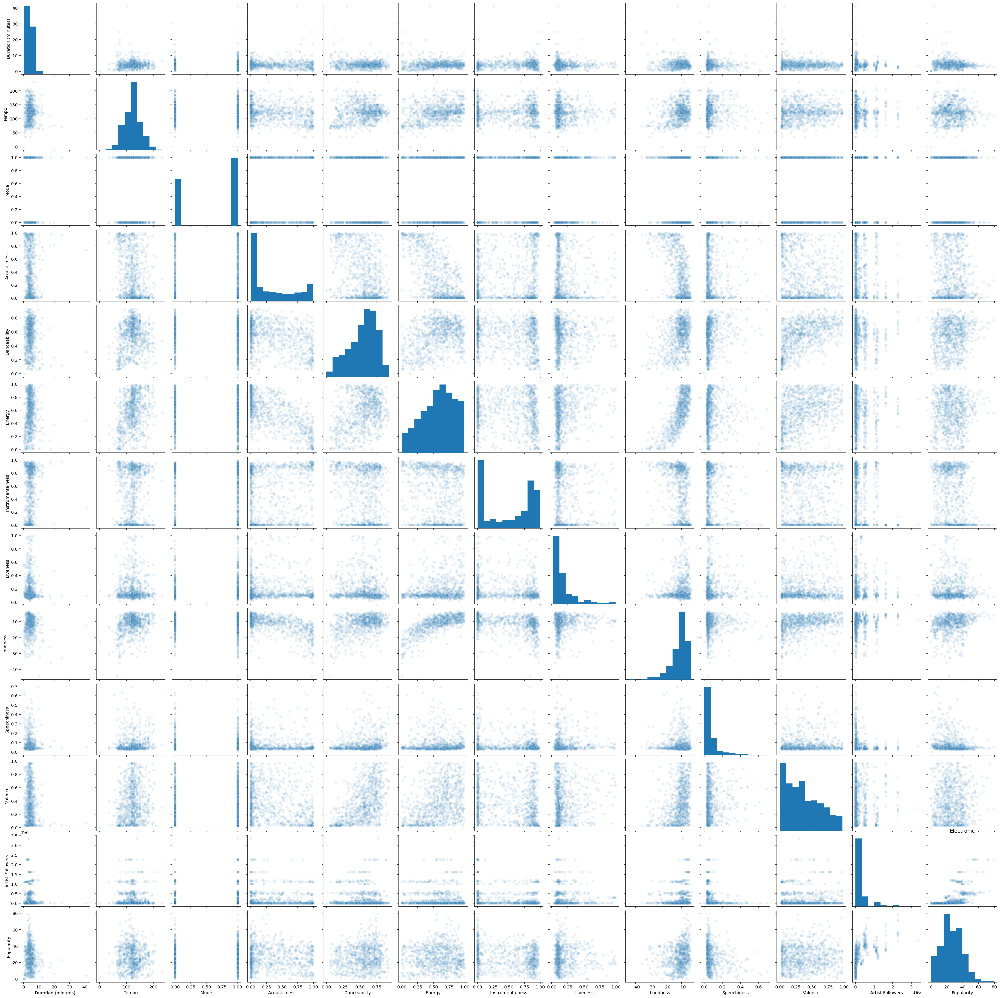

In [4]:
pair_plot_for_music_genre(dataset_v2, 'Electronic')

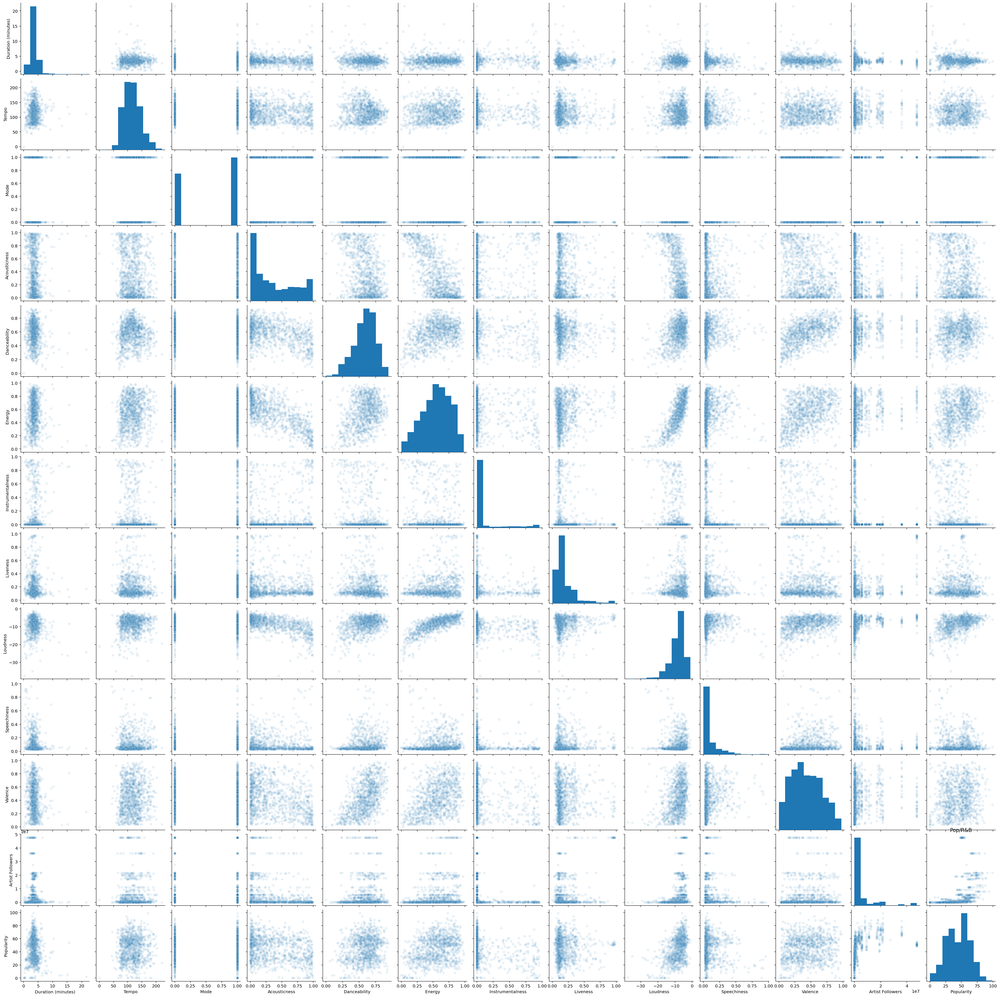

In [5]:
pair_plot_for_music_genre(dataset_v2, 'Pop/R&B')

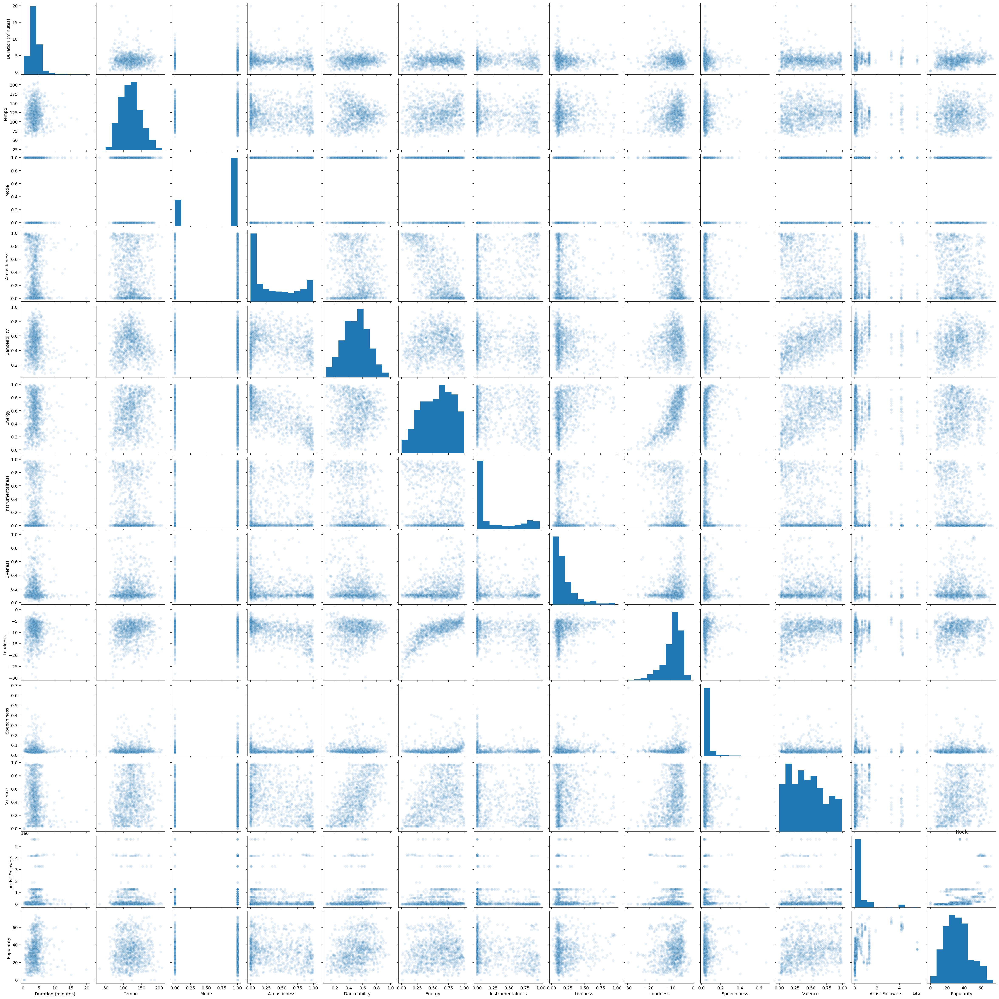

In [6]:
pair_plot_for_music_genre(dataset_v2, 'Rock')

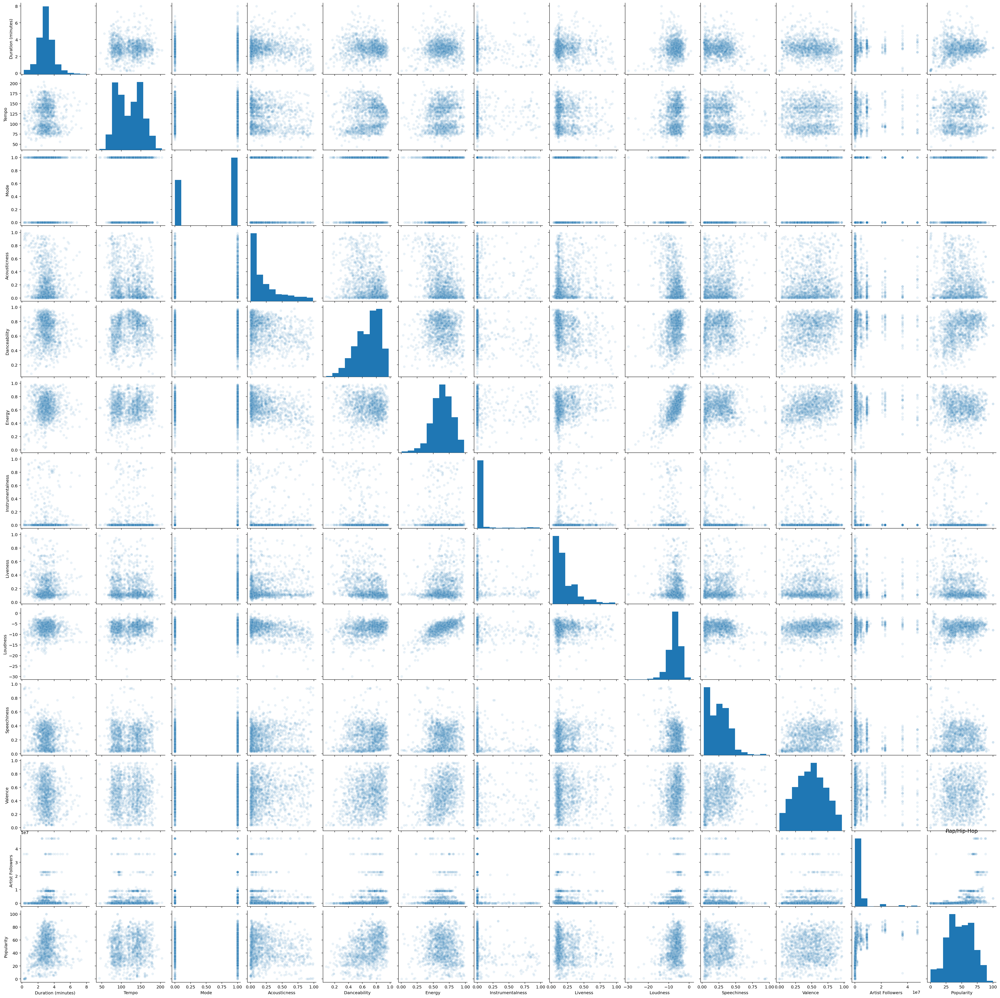

In [7]:
pair_plot_for_music_genre(dataset_v2, 'Rap/Hip-Hop')

Rap/Hip-Hop music appears to have the most promising pairplots. Additionally, it has the most well-distributed set of targets out of all of the genres. Intuitively, predicting popularity of multiple genres by the same parameteres doesn't make sense - people like different type of music for different reasons. For now I will pursue creating a model that predicts the popularity of Hip Hop music.

<h3><a id='stats'>Initial Statistics: Hip-Hop Tracks</a></h3>
    
Filter data to just hip hop and drop genre dummy variable columns.

In [8]:
df_hiphop = dataset_v2[dataset_v2['Rap/Hip-Hop'] == 1]
df_hiphop.drop(['Electronic', 'Experimental', 'Folk/Country', 'Global', 'Jazz', 
                'Metal', 'Pop/R&B', 'Rap/Hip-Hop', 'Rock'], axis=1, inplace=True)
df_hiphop.head()

,Duration (minutes),Tempo,Mode,Acousticness,Danceability,Energy,Instrumentalness,Liveness,Loudness,Speechiness,Valence,Artist Followers,Popularity
3577,2.94,108.966,0,0.38500,0.871,0.785,0.000279,0.197,-5.257,0.249,0.600,129033,30
3579,3.21,77.610,0,0.00766,0.407,0.830,0.000000,0.426,-4.468,0.407,0.307,129033,26
3581,4.84,82.393,0,0.02940,0.699,0.820,0.000000,0.118,-3.721,0.330,0.547,129033,26
3583,4.71,166.240,0,0.00819,0.356,0.959,0.000720,0.336,-5.718,0.540,0.515,129033,27
3585,4.59,79.656,1,0.21700,0.383,0.814,0.000003,0.261,-4.780,0.264,0.245,129033,25


Look at possible outliers.

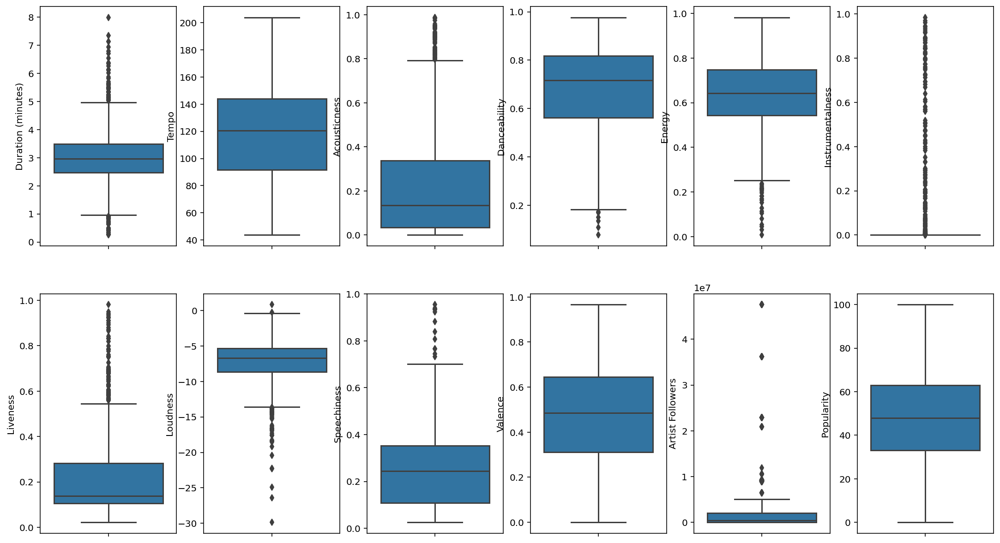

In [9]:
f, axes = plt.subplots(2, 6)
f.set_size_inches(18.5, 10.5)
sns.boxplot(df_hiphop['Duration (minutes)'], orient='v', ax=axes[0, 0])
sns.boxplot(df_hiphop['Tempo'], orient='v', ax=axes[0, 1])
sns.boxplot(df_hiphop['Acousticness'], orient='v', ax=axes[0, 2])
sns.boxplot(df_hiphop['Danceability'], orient='v', ax=axes[0, 3])
sns.boxplot(df_hiphop['Energy'], orient='v', ax=axes[0, 4])
sns.boxplot(df_hiphop['Instrumentalness'], orient='v', ax=axes[0, 5])
sns.boxplot(df_hiphop['Liveness'], orient='v', ax=axes[1, 0])
sns.boxplot(df_hiphop['Loudness'], orient='v', ax=axes[1, 1])
sns.boxplot(df_hiphop['Speechiness'], orient='v', ax=axes[1, 2])
sns.boxplot(df_hiphop['Valence'], orient='v', ax=axes[1, 3])
sns.boxplot(df_hiphop['Artist Followers'], orient='v', ax=axes[1, 4])
sns.boxplot(df_hiphop['Popularity'], orient='v', ax=axes[1, 5])

`statsmodels` gives us an initial look at coefficients and p-values with this feature set.

In [10]:
X = df_hiphop.drop('Popularity', axis=1)
y = df_hiphop['Popularity']

baseline_model = sm.OLS(y,X)
baseline_fit = baseline_model.fit()
baseline_fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:             Popularity   R-squared (uncentered):                   0.901
Model:                            OLS   Adj. R-squared (uncentered):              0.900
Method:                 Least Squares   F-statistic:                              948.6
Date:                Wed, 15 Jul 2020   Prob (F-statistic):                        0.00
Time:                        17:16:13   Log-Likelihood:                         -5307.0
No. Observations:                1263   AIC:                                  1.064e+04
Df Residuals:                    1251   BIC:                                  1.070e+04
Df Model:                          12                                                  
Covariance Type:            nonrobust                                                  
======================================================================================
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Duration (minutes)     3.4213      0.455      7.526      0.000       2.529       4.313
Tempo                  0.0674      0.014      4.718      0.000       0.039       0.095
Mode                  -1.7702      0.937     -1.890      0.059      -3.608       0.067
Acousticness           1.0878      2.096      0.519      0.604      -3.024       5.199
Danceability          39.8560      2.635     15.125      0.000      34.686      45.026
Energy                -2.5357      3.122     -0.812      0.417      -8.661       3.589
Instrumentalness      -8.9580      2.956     -3.031      0.002     -14.757      -3.159
Liveness              -4.4239      2.902     -1.524      0.128     -10.118       1.270
Loudness              -0.1970      0.163     -1.206      0.228      -0.517       0.123
Speechiness           -4.2085      3.146     -1.338      0.181     -10.380       1.963
Valence                3.6458      2.386      1.528      0.127      -1.035       8.326
Artist Followers    9.875e-07   6.05e-08     16.328      0.000    8.69e-07    1.11e-06
==============================================================================
Omnibus:                        0.829   Durbin-Watson:                   0.569
Prob(Omnibus):                  0.661   Jarque-Bera (JB):                0.893
Skew:                          -0.056   Prob(JB):                        0.640
Kurtosis:                       2.935   Cond. No.                     7.06e+07
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 7.06e+07. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

Plot a correlation matrix.

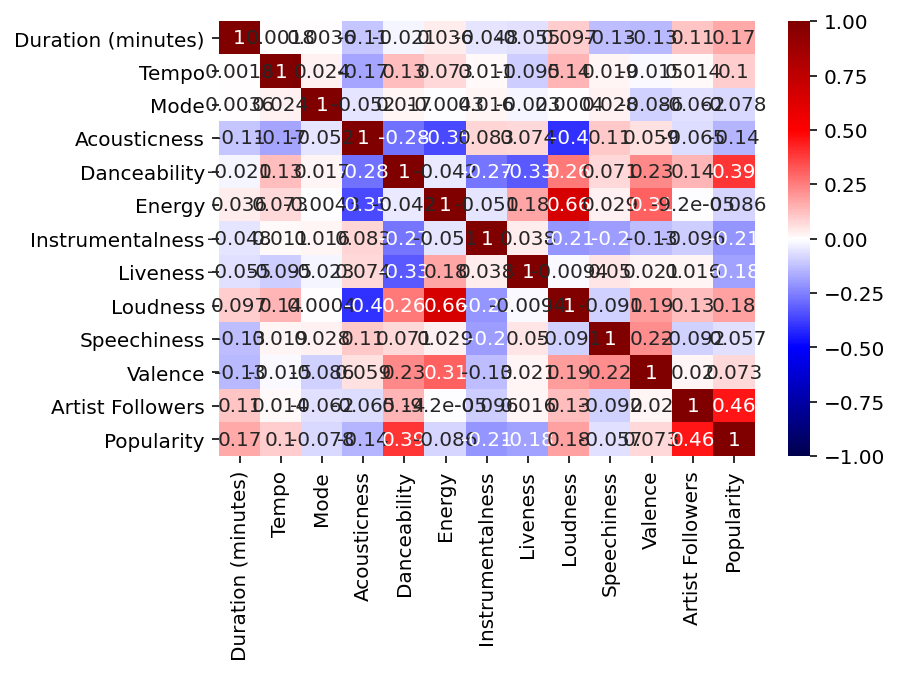

In [11]:
sns.heatmap(df_hiphop.corr(), cmap="seismic", annot=True, vmin=-1, vmax=1)

#### Takeaways

* Based on the pairplot and correlation matrix, the following possible multicolinearities might cause issues:
    - Loudness & Energy
    - Valence & Energy
* Danceability and Artist Followers have strong correlations with the targets. A few other features show promise.
* The data seems sparse and I might benefit from more?

<h3><a id='log-followers'>Log-Transforming "Artist Followers" Feature</a></h3>

Number of followers seems to have a log relationship with the target. What happens if I were to create a log feature?

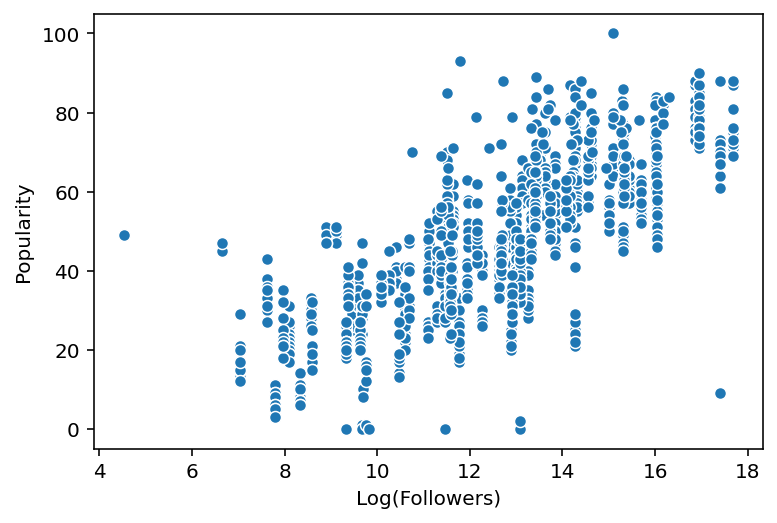

In [12]:
df_hiphop_feature_eng = df_hiphop.copy()
df_hiphop_feature_eng['Log(Followers)'] = np.log(df_hiphop['Artist Followers'])

sns.scatterplot(x='Log(Followers)', y='Popularity', data=df_hiphop_feature_eng)

Looks very promising. Correlation matrix confirms this.

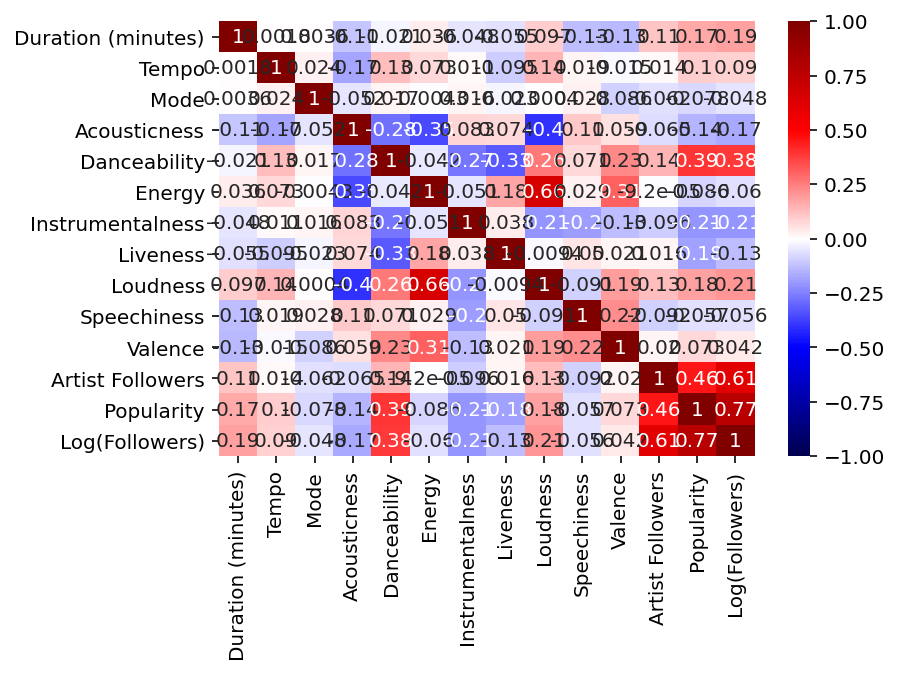

In [13]:
sns.heatmap(df_hiphop_feature_eng.corr(), cmap="seismic", annot=True, vmin=-1, vmax=1)

Drop `Artist Followers` from model since `Log(Followers)` is much better.

In [14]:
df_hiphop_feature_eng.drop('Artist Followers', axis=1, inplace=True)

<h2><a id=modeling>Modeling</a></h2>
 
First set aside test set.

In [15]:
X_feature_eng = df_hiphop_feature_eng.drop('Popularity', axis=1)
y_feature_eng = df_hiphop_feature_eng['Popularity']
X_train_val, X_test, y_train_val, y_test = train_test_split(X_feature_eng, y_feature_eng, 
                                                            test_size=0.2, random_state=42)

<h3><a id='baseline'>Baseline Linear Regression Model</a></h3>

The first task is to see how a simple linear regression model does on the features I've selected/engineered. Based on if the initial model appears to be overfitting/underfitting, I can make some modeling decisions.

In [20]:
score_baseline_linear_regression_model(X_train_val, y_train_val)

NameError: name 'np' is not defined

After executing the above cell a handfull of times, the following things are evident:

- The initial R2 score is pretty good for a baseline model...ranges from 0.60-0.63 most of the time.
- Most of the time the train score exceeds the validation score by more than a few percent. **This indicates possible overfitting.**
- The RMSE score is pretty good from a practical perspective. It indicates that, if for instance, the actual popularity score of a song on Spotify is 70, my model will probably yield a value between 60 and 80.

The best path forward is to experiment with using a LASSO or Ridge regression to improve the model by reducing complexity in the features.

<h3><a id='reducing-overfit'>Reducing Overfitting / Model Complexity: Selecting LASSO vs. Ridge</a></h3>

In order to observe if LASSO or Ridge regression improves overfitting, I must take a look at the train score and validation score for each. (A slightly more manual process than LassoCV/RidgeCV).

#### LASSO

In [ ]:
for alpha in [0.01, 0.1, 1, 10]:
    print(f'For alpha = {alpha}')
    manual_cross_validate(X_train_val, y_train_val, Lasso(alpha))
    print('---------')
    print('---------')

LASSO does a pretty good job of improving overfitting by removing variables/complexity.

#### Ridge

In [ ]:
for alpha in [0.01, 0.1, 1, 10]:
    print(f'For alpha = {alpha}')
    manual_cross_validate(X_train_val, y_train_val, Ridge(alpha))
    print('---------')
    print('---------')

Ridge does a similar job with a slightly better R2 overall.

<h3><a id='removing'>Experiment: Pre-Removing Features that LASSO Removed & Re-Running Different Models</a></h3>

#### Baseline Linear Regression with Features Removed

In [ ]:
X_features_removed = X_train_val.drop(['Duration (minutes)', 'Tempo', 'Acousticness', 'Instrumentalness', 
                                       'Loudness', 'Speechiness', 'Valence'], axis=1)
score_baseline_linear_regression_model(X_features_removed, y_train_val)

Running it several time, results are all over the place, but generally doesn't seem to be much better.

#### LASSO with Features Already Removed

In [ ]:
for alpha in [0.01, 0.1, 1, 10]:
    print(f'For alpha = {alpha}')
    manual_cross_validate(X_features_removed, y_train_val, Lasso(alpha))
    print('---------')
    print('---------')

No improvement. Makes sense since the Lasso only removed those features in the first place.

#### Ridge with Features Already Removed

In [ ]:
X_features_removed_2 = X_features_removed.drop('Mode', axis=1)
for alpha in [0.01, 0.1, 1, 10]:
    print(f'For alpha = {alpha}')
    manual_cross_validate(X_features_removed_2, y_train_val, Ridge(alpha))
    print('---------')
    print('---------')

This seems to yield the best combo of lower overfitting, lower RMSE, and highest R2.

<h3><a id='poly'>Experiment: Polynomial Regression</a></h3>
    
Polynomial regression shouldn't really improve my model since it isn't underfitting, but running a polynomial regression through LASSO might be interesting.

In [ ]:
poly = PolynomialFeatures(2)
X_features_removed_poly = poly.fit_transform(X_features_removed)
for alpha in [0.01, 0.1, 1, 10]:
    print(f'For alpha = {alpha}')
    manual_cross_validate_poly(X_features_removed_poly, y_train_val, Lasso(alpha))
    print('---------')
    print('---------')

Zero in on alpha.

In [ ]:
for alpha in np.arange(0.05, 0.15, 0.01):
    print(f'For alpha = {alpha}')
    manual_cross_validate_poly(X_features_removed_poly, y_train_val, Lasso(alpha))
    print('---------')
    print('---------')

This actually yielded some competitive models, but I'm going to stick with Ridge because it's just as good and simpler.

<h3><a id='tuning'>Tuning Final Ridge Regression Model</a></h3>

Using a more efficient implementation of Ridge w Cross Validation to tune the hyperparameters.

In [ ]:
l2 = RidgeCV(cv=5)
pipe = Pipeline([('scaler', StandardScaler()), ('ridge', l2)])
pipe.fit(X_features_removed, y_train_val)
pipe.score(X_features_removed, y_train_val)

In [ ]:
pipe.named_steps['ridge'].alpha_

Zero in on tuning for alpha.

In [ ]:
l2 = RidgeCV(alphas=range(1,50), cv=5)
pipe = Pipeline([('scaler', StandardScaler()), ('ridge', l2)])
pipe.fit(X_features_removed, y_train_val)
pipe.score(X_features_removed, y_train_val)

In [ ]:
pipe.named_steps['ridge'].alpha_

In [ ]:
math.sqrt(mean_squared_error(y_train_val, pipe.predict(X_features_removed)))

<h3><a id='assumptions'>Evaluating Model on Linear Regression Assumptions</a></h3>

From here I think I have the best model I'm going to get with linear regression. Looking at residuals will give me a final assessment on if my model is meeting linear regression assumptions.

#### Residuals

In [ ]:
y_pred = pipe.predict(X_features_removed)
residuals = y_train_val - y_pred
plt.scatter(x=y_pred, y=residuals)

In [ ]:
from scipy import stats
stats.probplot(residuals, dist="norm", plot=plt)
plt.title("Normal Q-Q plot")

Nothing overly concerning here. For the residual plot, the values seem to be fairly symmetric around y=0 with maybe some slight chang ein variance in the mid range of predictions. The QQ plot follows a normal trend.

#### Distribution of Predictions

In [ ]:
plt.hist(y_pred, bins=25)

Finally, the predictions are approximately normally distributed, with some skew. While I expect there to be ways to further tune the model, based on my time limitations, I am going to settle with the final ridge model defined above.

<h2><a id='final-modeling'>Final Model</a></h2>

Prepare data for final model.

In [ ]:
X_train_val_final = X_features_removed

scaler = StandardScaler()
X_train_val_final_scaled = scaler.fit_transform(X_train_val_final)

X_test_final = X_test.drop(['Duration (minutes)', 'Tempo', 'Acousticness', 'Instrumentalness', 
                            'Loudness', 'Speechiness', 'Valence'], axis=1)
X_test_final_scaled = scaler.transform(X_test_final)

Score final model.

In [ ]:
final_model.fit(X_train_val_final_scaled, y_train_val)
print(f'Final R2 Score: {final_model.score(X_test_final_scaled, y_test)}')

rmse = math.sqrt(mean_squared_error(y_test, final_model.predict(X_test_final_scaled)))
print(f'Final RMSE Score: {rmse}')

Persist final model.

In [18]:
# make pip work
from joblib import dump
dump(final_model, '../data/final_model.pkl')

NameError: name 'final_model' is not defined

In [19]:
dump(pipe, '../data/final_model.pkl')

NameError: name 'pipe' is not defined